<a href="https://colab.research.google.com/github/Memoona028/Plant-disease-detection-ANN-Project-/blob/main/ANN_Project_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#####Dataset Source : https://data.mendeley.com/datasets/tywbtsjrjv/1

#####Base Paper Source : https://arxiv.org/ftp/arxiv/papers/1604/1604.03169.pdf

###Description
- This dataset consists of 55,448  healthy and unhealthy leaf images divided into 38 categories by species and disease.


####Extracting the zip file from drive

In [ ]:
from google.colab import drive
import zipfile
import os

# Mount Google Drive
drive.mount('/content/drive')

# Path to the zip file in your Google Drive
zip_file_path = '/content/drive/My Drive/Plant_leaf_diseases_dataset_1.zip'


# Directory to extract the contents of the zip file
extract_dir = '/content/drive/My Drive/'

# Extracting  the zip file
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extract_dir)

# Checking the contents of the extracted directory
extracted_files = os.listdir(extract_dir)
print("Extracted files from drive :", extracted_files)

Mounted at /content/drive


- Checking the no of pictures

In [ ]:
# Path to the main folder containing subfolders with images
main_folder_path = '/content/drive/MyDrive/Plant_leave_diseases_dataset_1'
def count_images_in_subfolders(main_folder_path):
    total_images = 0
    for folder_name in os.listdir(main_folder_path):
        folder_path = os.path.join(main_folder_path, folder_name)
        if os.path.isdir(folder_path):
            # Count the number of images within the current folder
            # Create a list to filter out only files.
            images_in_folder = len([file for file in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, file))])
            # Add the number of images in the current folder to the total count
            total_images += images_in_folder
    return total_images

# Getting the total number of images in subfolders
total_images = count_images_in_subfolders(main_folder_path)
print("Total number of images in subfolders:", total_images)


Total number of images in subfolders: 54305


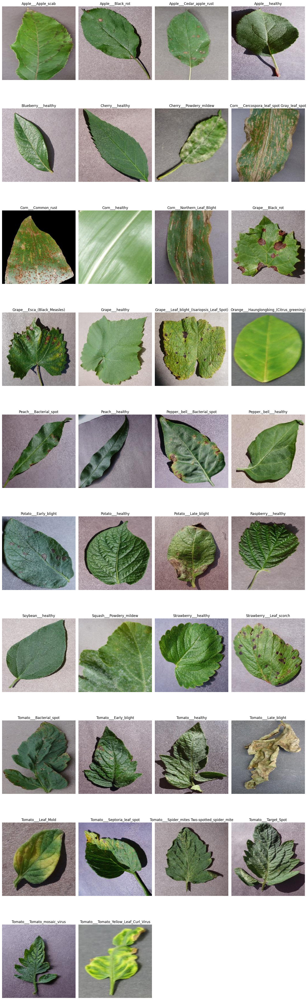

In [ ]:

main_folder_path = '/content/drive/MyDrive/Plant_leave_diseases_dataset_1'

num_images_per_row = 4
num_classes = len(os.listdir(main_folder_path))
num_rows = (num_classes + num_images_per_row - 1) // num_images_per_row

# Create the figure
plt.figure(figsize=(15, 5 * num_rows))

# Iterate over unique plant classes
for i, plant_class in enumerate(os.listdir(main_folder_path)):
    # Calculate the subplot index
    subplot_index = i + 1

    # Calculate the row and column indices for the subplot
    row_index = subplot_index // num_images_per_row
    col_index = subplot_index % num_images_per_row

    # Create the subplot
    plt.subplot(num_rows, num_images_per_row, subplot_index)

    # Get the path of the first image for the current plant class
    class_folder_path = os.path.join(main_folder_path, plant_class)
    image_files = [f for f in os.listdir(class_folder_path) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    if image_files:
        sample_image_path = os.path.join(class_folder_path, image_files[0])
        sample_image = cv2.imread(sample_image_path)
        if sample_image is not None:
            plt.imshow(cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB))
            plt.title(plant_class)
            plt.axis('off')
        else:
            print(f"Error: Unable to load image from path: {sample_image_path}")
    else:
        print(f"Error: No images found in folder: {class_folder_path}")

# Adjust layout and display the plot
plt.tight_layout()
plt.show()


- Here we can see that folder named as 'Background_without_leaves' which is irrelevent to our dataset so we have to delete it first using **rmtree()** func

- checking the no of folders now

In [ ]:

# Path
dataset_dir = '/content/drive/MyDrive/Plant_leave_diseases_dataset_1'

# List all files and directories in the dataset directory
contents = os.listdir(dataset_dir)

# Filter out only the directories
folders = [folder for folder in contents if os.path.isdir(os.path.join(dataset_dir, folder))]

# then count the number of folders
num_folders = len(folders)

print(f"No of folders in the dataset: {num_folders}")


Number of folders in the dataset: 38


- Total no of images in our dataset

In [ ]:
# Initialize the count variable
image_count = 0

# Iterating over each folder in the dataset directory
for root, dirs, files in os.walk(dataset_dir):
    # Count the files with image extensions in each folder
    image_count += sum(1 for file in files if file.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp', '.gif')))

print(f"Number of images in the dataset: {image_count}")


Number of images in the dataset: 54305


   - Here we can see that initally there were 55,448 images in our dataset but after deleting that irrelevent folder from our dataset we are left with **54,305** images

# Data Preprocessing
##Data Preprocessing Steps
- Let’s take a look at the established steps you’ll need to go through to make sure your data is successfully preprocessed.

 - Data quality assessment
 - Data cleaning
 - Data transformation
 - Data reduction
- Techniques applied
    - Resizing
    - Rescaling
    - Data Augmentation

- Importing dependencies

In [4]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, img_to_array, save_img
import cv2
import os
import shutil
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline



- Checking whether is there any empty folder

In [ ]:
def is_folder_empty(folder_path):
    # List all contents of the folder
    contents = os.listdir(folder_path)
    # Check if the folder is empty
    if len(contents) == 0:
        return True
    # Check if any subfolders are empty
    for item in contents:
        item_path = os.path.join(folder_path, item)
        if os.path.isdir(item_path):
            if is_folder_empty(item_path):
                return True
    return False

# Parent folder(main folder) to check
parent_folder_path = '/content/drive/MyDrive/Plant_leave_diseases_dataset_1'

# Check if the parent folder or any of its subfolders are empty
if is_folder_empty(parent_folder_path):
    print("The parent folder or one of its subfolders is empty.")
else:
    print("The parent folder's subfolders contain images,hence not empty  .")


The parent folder's subfolders contain images,hence not empty  .


In [ ]:
parent_folder_path = '/content/drive/MyDrive/Plant_leave_diseases_dataset_1'

# Get a list of all files and directories in the parent folder
contents = os.listdir(parent_folder_path)

# Filter out only the directories
subfolders = [folder for folder in contents if os.path.isdir(os.path.join(parent_folder_path, folder))]

# Print the names of all subfolders
for folder in subfolders:
    print(folder)

Apple___Apple_scab
Apple___Black_rot
Apple___Cedar_apple_rust
Apple___healthy
Blueberry___healthy
Cherry___healthy
Cherry___Powdery_mildew
Corn___Cercospora_leaf_spot Gray_leaf_spot
Corn___Common_rust
Corn___healthy
Corn___Northern_Leaf_Blight
Grape___Black_rot
Grape___Esca_(Black_Measles)
Grape___healthy
Grape___Leaf_blight_(Isariopsis_Leaf_Spot)
Orange___Haunglongbing_(Citrus_greening)
Peach___Bacterial_spot
Peach___healthy
Pepper,_bell___Bacterial_spot
Pepper,_bell___healthy
Potato___Early_blight
Potato___healthy
Potato___Late_blight
Raspberry___healthy
Soybean___healthy
Squash___Powdery_mildew
Strawberry___healthy
Strawberry___Leaf_scorch
Tomato___Bacterial_spot
Tomato___Early_blight
Tomato___healthy
Tomato___Late_blight
Tomato___Leaf_Mold
Tomato___Septoria_leaf_spot
Tomato___Spider_mites Two-spotted_spider_mite
Tomato___Target_Spot
Tomato___Tomato_mosaic_virus
Tomato___Tomato_Yellow_Leaf_Curl_Virus


In [ ]:
#shutil provides functions for managing files and directories in Python programs here we used one for deletinga  folder

# provide a path to that specific folder
subfolder_path = '/content/drive/MyDrive/Plant_leave_diseases_dataset_without_1/Background_without_leaves'

# Deleting the subfolder
shutil.rmtree(subfolder_path)

print(f"Subfolder '{subfolder_path}' deleted successfully.")


Here we generally made a resized iamges dataset but we did the actual resizing in preprocessing layers

In [ ]:


def resize_images_in_folder(input_folder, output_folder, target_size):
    # Create the output folder if it doesn't exist
    os.makedirs(output_folder, exist_ok=True)

    # Iterate through subfolders in the input folder
    for root, dirs, files in os.walk(input_folder):
        for dir_name in dirs:
            # Get the full path of the current subfolder
            subdir_path = os.path.join(root, dir_name)

            # Create the corresponding subfolder in the output directory
            output_subdir = os.path.join(output_folder, os.path.relpath(subdir_path, input_folder))
            os.makedirs(output_subdir, exist_ok=True)

            # Iterate through files in the current subfolder
            for file_name in os.listdir(subdir_path):
                # Check if the file is an image
                if file_name.lower().endswith(('.jpg', '.jpeg', '.png')):
                    # Load the image
                    image_path = os.path.join(subdir_path, file_name)
                    image = load_img(image_path)

                    # Resize the image
                    resized_image = tf.image.resize(img_to_array(image), target_size)

                    # Save the resized image to the output folder
                    output_path = os.path.join(output_subdir, file_name)
                    save_img(output_path, resized_image)

# Example usage:
input_folder = '/content/drive/MyDrive/Plant_leave_diseases_dataset_1'  # Path to input folder with subfolders containing images
output_folder = '/content/drive/MyDrive/Plant_leave_disease_resize_images_dataset'  # Path to output folder to save resized images
target_size = (256, 256)  # Target size for resizing images

resize_images_in_folder(input_folder, output_folder, target_size)


Exploring dataset by making a dataframe

In [ ]:
data_dir='/content/drive/MyDrive/Plant_leave_disease_resize_images_dataset'
keyword=["Apple","Corn","Potato","Grape", "Peach","Tomato"]
class_folders = os.listdir(data_dir)
image_paths = []
labels = []

for class_folder in class_folders:
    for key in keyword:
        if key in class_folder:
            class_path = os.path.join(data_dir, class_folder)
            image_files = os.listdir(class_path)
            for image_file in image_files:
                image_path = os.path.join(class_path, image_file)
                image_paths.append(image_path)
                labels.append(class_folder)

df = pd.DataFrame({'image_path': image_paths, 'label': labels})

In [ ]:
print("The classes:\n", np.unique(df['label']))

The classes:
 ['Apple___Apple_scab' 'Apple___Black_rot' 'Apple___Cedar_apple_rust'
 'Apple___healthy' 'Corn___Cercospora_leaf_spot Gray_leaf_spot'
 'Corn___Common_rust' 'Corn___Northern_Leaf_Blight' 'Corn___healthy'
 'Grape___Black_rot' 'Grape___Esca_(Black_Measles)'
 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)' 'Grape___healthy'
 'Peach___Bacterial_spot' 'Peach___healthy' 'Potato___Early_blight'
 'Potato___Late_blight' 'Potato___healthy' 'Tomato___Bacterial_spot'
 'Tomato___Early_blight' 'Tomato___Late_blight' 'Tomato___Leaf_Mold'
 'Tomato___Septoria_leaf_spot'
 'Tomato___Spider_mites Two-spotted_spider_mite' 'Tomato___Target_Spot'
 'Tomato___Tomato_Yellow_Leaf_Curl_Virus' 'Tomato___Tomato_mosaic_virus'
 'Tomato___healthy']


- we gave keyword containing different classes name to make a dataframe using pandas to explor our dataset as we can see it is shown in tht outptu it showed all those classes/folders which contained that keyword

In [ ]:
df.head(10)

,image_path,label
0,/content/drive/MyDrive/Plant_leave_diseases_da...,Apple___Apple_scab
1,/content/drive/MyDrive/Plant_leave_diseases_da...,Apple___Apple_scab
2,/content/drive/MyDrive/Plant_leave_diseases_da...,Apple___Apple_scab
3,/content/drive/MyDrive/Plant_leave_diseases_da...,Apple___Apple_scab
4,/content/drive/MyDrive/Plant_leave_diseases_da...,Apple___Apple_scab
5,/content/drive/MyDrive/Plant_leave_diseases_da...,Apple___Apple_scab
6,/content/drive/MyDrive/Plant_leave_diseases_da...,Apple___Apple_scab
7,/content/drive/MyDrive/Plant_leave_diseases_da...,Apple___Apple_scab
8,/content/drive/MyDrive/Plant_leave_diseases_da...,Apple___Apple_scab
9,/content/drive/MyDrive/Plant_leave_diseases_da...,Apple___Apple_scab


In [ ]:
df.tail(10)

,image_path,label
34044,/content/drive/MyDrive/Plant_leave_diseases_da...,Tomato___Tomato_Yellow_Leaf_Curl_Virus
34045,/content/drive/MyDrive/Plant_leave_diseases_da...,Tomato___Tomato_Yellow_Leaf_Curl_Virus
34046,/content/drive/MyDrive/Plant_leave_diseases_da...,Tomato___Tomato_Yellow_Leaf_Curl_Virus
34047,/content/drive/MyDrive/Plant_leave_diseases_da...,Tomato___Tomato_Yellow_Leaf_Curl_Virus
34048,/content/drive/MyDrive/Plant_leave_diseases_da...,Tomato___Tomato_Yellow_Leaf_Curl_Virus
34049,/content/drive/MyDrive/Plant_leave_diseases_da...,Tomato___Tomato_Yellow_Leaf_Curl_Virus
34050,/content/drive/MyDrive/Plant_leave_diseases_da...,Tomato___Tomato_Yellow_Leaf_Curl_Virus
34051,/content/drive/MyDrive/Plant_leave_diseases_da...,Tomato___Tomato_Yellow_Leaf_Curl_Virus
34052,/content/drive/MyDrive/Plant_leave_diseases_da...,Tomato___Tomato_Yellow_Leaf_Curl_Virus
34053,/content/drive/MyDrive/Plant_leave_diseases_da...,Tomato___Tomato_Yellow_Leaf_Curl_Virus


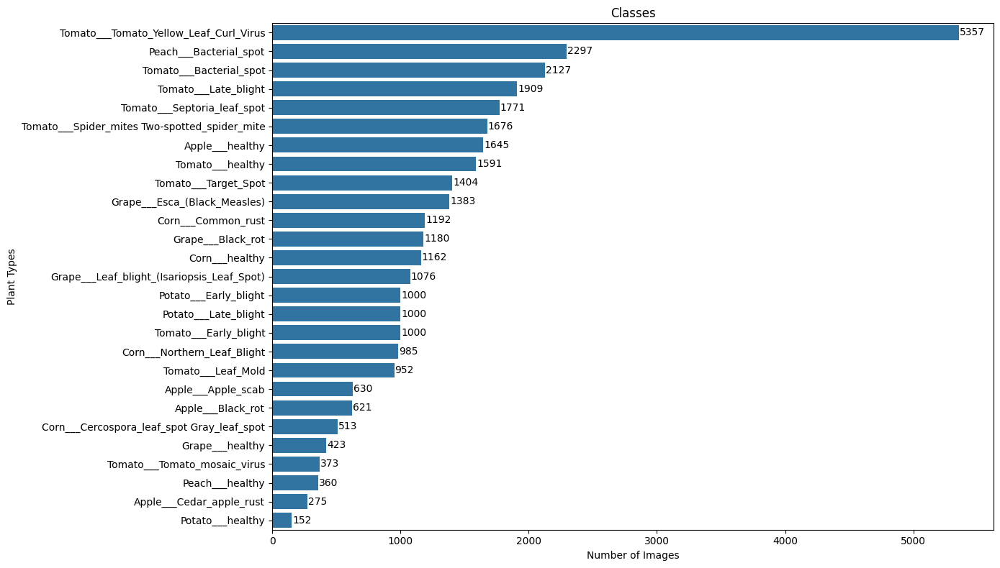

In [ ]:
class_counts = df['label'].value_counts()

plt.figure(figsize=(14, 8))
x = sns.barplot(x=class_counts.values, y=class_counts.index, orient='h')
plt.title('Classes')
plt.xlabel('Number of Images')
plt.ylabel('Plant Types')
plt.tight_layout()

for i, v in enumerate(class_counts.values):
    x.text(v + 5, i, str(v), color='black', va='center')

plt.show()

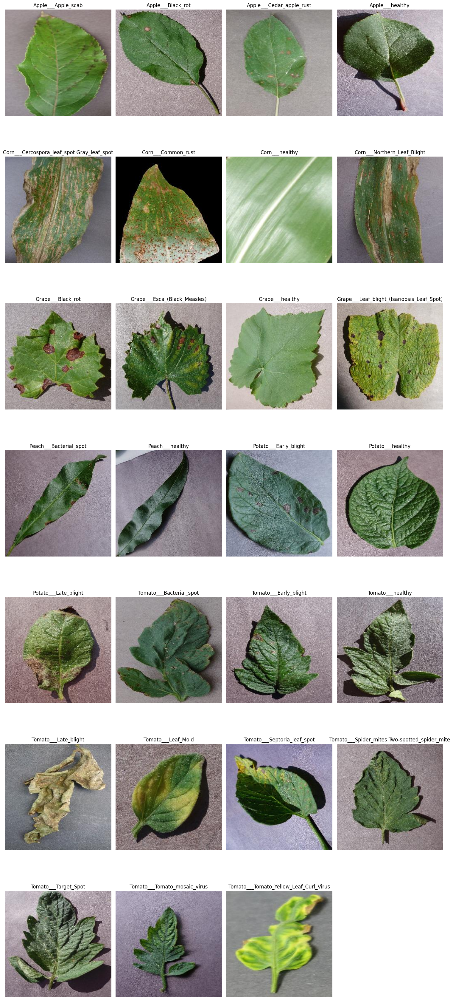

In [ ]:
num_classes = len(df['label'].unique())

num_images_per_row = 4
num_rows = (num_classes + num_images_per_row - 1) # num_images_per_row

plt.figure(figsize=(15, 5 * num_rows))

for i, plant_class in enumerate(df['label'].unique()):
    plt.subplot(num_rows, num_images_per_row, i + 1)
    path = os.path.join(data_dir, df[df['label'] == plant_class]['image_path'].iloc[0])

    if os.path.exists(path):
        sample_image = cv2.imread(path)
        if sample_image is not None:
            plt.imshow(cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB))
            plt.title(plant_class)
            plt.axis('off')
        else:
            print(f"Error: Unable to load image from path: {path}")
    else:
        print(f"Error: Image path does not exist: {path}")

plt.tight_layout()
plt.show()

####Loading dataset to folder using tf

In [35]:
from tensorflow.keras import models,layers

In [6]:

dataset_folder = '/content/drive/MyDrive/Plant_leave_disease_resize_images_dataset'
epochs=50 #hyperparameter
# Loading image dataset using TensorFlow's data preprocessing utilities
image_dataset = tf.keras.preprocessing.image_dataset_from_directory(
    dataset_folder,
    image_size=(256, 256),
    batch_size=32,
    label_mode='categorical' ,# categorical as we have diff classes for diseaese
    shuffle= True,

)

# or we can set image size in many ways if we set im_size=256 we can just write image_size=(im_size,im_size)

Found 54305 files belonging to 38 classes.


In [ ]:
classes= image_dataset.class_names

In [ ]:
classes

['Apple___Apple_scab',
 'Apple___Black_rot',
 'Apple___Cedar_apple_rust',
 'Apple___healthy',
 'Blueberry___healthy',
 'Cherry___Powdery_mildew',
 'Cherry___healthy',
 'Corn___Cercospora_leaf_spot Gray_leaf_spot',
 'Corn___Common_rust',
 'Corn___Northern_Leaf_Blight',
 'Corn___healthy',
 'Grape___Black_rot',
 'Grape___Esca_(Black_Measles)',
 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)',
 'Grape___healthy',
 'Orange___Haunglongbing_(Citrus_greening)',
 'Peach___Bacterial_spot',
 'Peach___healthy',
 'Pepper,_bell___Bacterial_spot',
 'Pepper,_bell___healthy',
 'Potato___Early_blight',
 'Potato___Late_blight',
 'Potato___healthy',
 'Raspberry___healthy',
 'Soybean___healthy',
 'Squash___Powdery_mildew',
 'Strawberry___Leaf_scorch',
 'Strawberry___healthy',
 'Tomato___Bacterial_spot',
 'Tomato___Early_blight',
 'Tomato___Late_blight',
 'Tomato___Leaf_Mold',
 'Tomato___Septoria_leaf_spot',
 'Tomato___Spider_mites Two-spotted_spider_mite',
 'Tomato___Target_Spot',
 'Tomato___Tomato_Yellow_Lea

In [17]:
ds_size=len(image_dataset)

In [ ]:
#rough idea
1698 * 32
#each item having batch of 32

54336

In [ ]:
# Iterate through batches of the dataset
# Iterate through batches of the dataset
for image_batch, label_batch in image_dataset.take(1):
    print(image_batch.shape)
    print(label_batch.shape)  # Get the number of classes (number of label dimensions)
    break  # Break the loop after printing the first batch


(32, 256, 256, 3)
(32, 38)


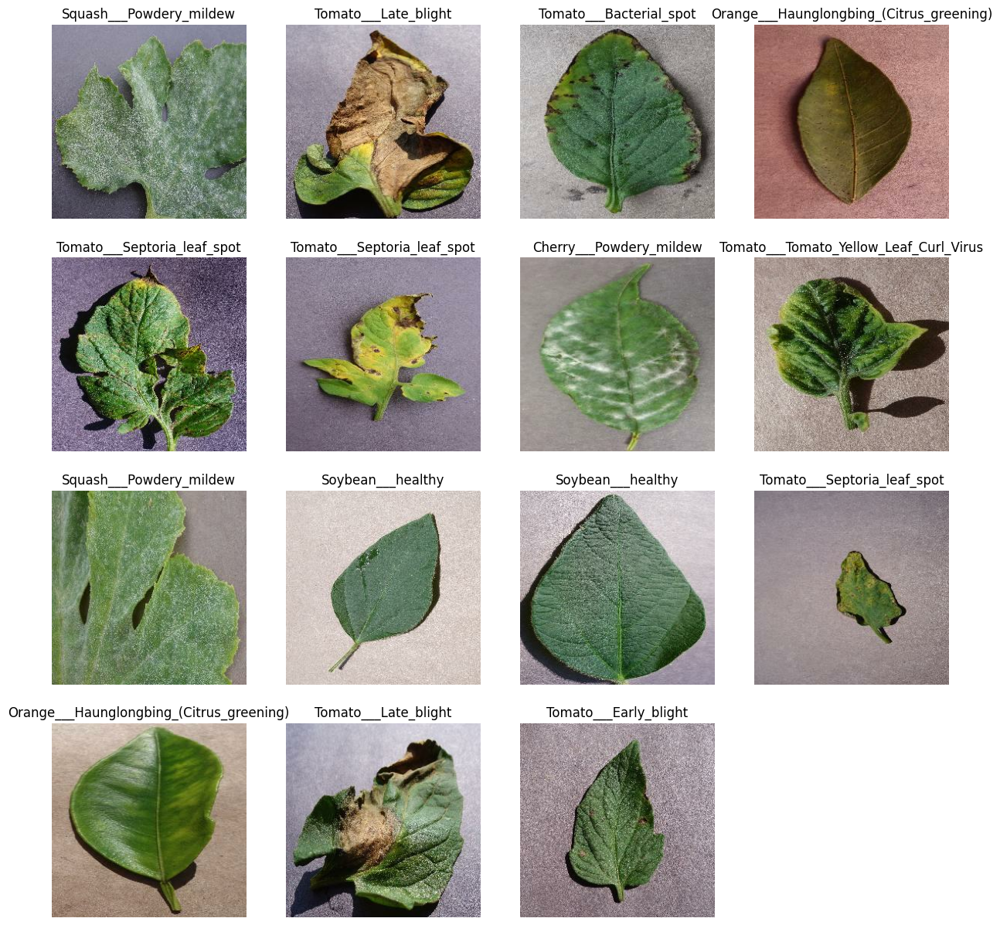

In [ ]:
# Iterate through the first batch of the dataset
plt.figure(figsize=(15,15))
for image_batch, label_batch in image_dataset.take(1):
    # Iterate through each image in the batch
    for i in range(15):
        plt.subplot(4, 4, i+1)  # Change to 4 rows and 4 columns
        plt.imshow(image_batch[i].numpy().astype("uint8"))
        label_index = tf.argmax(label_batch[i]).numpy()
        class_name = classes[label_index]
        plt.title(class_name)
        plt.axis('off')

plt.show()


#####The next step -> divide the dataset
- 80% -> training
- 20% -> 10% validation , 10% test

In [7]:
train_ds_size= 0.8
len(image_dataset)* train_ds_size

1358.4

In [9]:
train_dataset=image_dataset.take(1358)
len(train_dataset)

1358

In [10]:
#by skipping those 1358 train dataset we can get our train dataset
test_dataset=image_dataset.skip(1358)
len(test_dataset)

340

In [11]:
#now we have to gather validation dataset
val_size=0.1
len(image_dataset)*val_size

169.8

In [12]:
validation_dataset= test_dataset.take(169)
len(validation_dataset)

169

In [13]:
#now the actual test dataset
test_dataset=test_dataset.skip(169)
len(test_dataset)

171

- wrapping all these dataset into a func


In [24]:
def datasets_partition(ds,train_split=0.8,val_split=0.1,test_split=0.1,shuffle=True,shuffle_size=1000):
  ds_size=len(image_dataset)
  if shuffle:
      ds=ds.shuffle(shuffle_size,seed=12)
  train_ds_size=int(train_split* ds_size)#int () used to avoid float nums
  val_ds_size=int(val_split*ds_size)
  #test
  train_ds=ds.take(train_ds_size)
  test_ds=ds.skip(train_ds_size).take(val_ds_size)
  val_ds=ds.skip(train_ds_size).skip(val_ds_size)

  return train_ds,test_ds,val_ds

In [25]:
train_ds,test_ds,val_ds=datasets_partition(image_dataset)

In [27]:
len(train_ds),len(test_ds),len(val_ds)

(1358, 169, 171)

In [28]:
#here we are increasing performance quality(optimization) by teling tf to load how many how many batches while gpu is training
train_ds=train_ds.cache().shuffle(1000).prefetch(buffer_size=tf.data.AUTOTUNE)
test_ds=test_ds.cache().shuffle(1000).prefetch(buffer_size=tf.data.AUTOTUNE)
val_ds=val_ds.cache().shuffle(1000).prefetch(buffer_size=tf.data.AUTOTUNE)

Scaling(to get no btw 0 and 1)

In [33]:
img_size = 256

In [36]:
resize_and_rescale=tf.keras.Sequential([
    #resizing
    layers.experimental.preprocessing.Rescaling(img_size,img_size),
    layers.experimental.preprocessing.Rescaling(1.0/255)

])
#we will supply this layer to our model later
#here we have to resize again incase when this layer go to modeland then during prediction if any img is not 256 it will take care of that


Data Augmentation for robustness

In [37]:
data_augment=tf.keras.Sequential([
    layers.experimental.preprocessing.RandomFlip("horizontal_and_vertical"),
    layers.experimental.preprocessing.RandomRotation(0.2)
])